In [1]:
from google.colab import drive
import sys

drive.mount('/content/gdrive/')
path = '/content/gdrive/MyDrive/Entrega ZANE/'
sys.path.append(path)
# path='./'

# Boxplots 

## Objetivos:

Este notebook gera boxplots para a variável *consumo* separada por *motorista* e *número de frota*.

O notebook está dividido em **8 partes**:
 - Box por frota e por veículo
    - Separando por tipo de veículo
 - Consumo por mês de frota ou veículo
    - Separando por tipo de veículo
 - Evolução do consumo ao longo do tempo de frota ou veículo
    - Separando por tipo de veículo
 - Consumo por combinação de frota e motorista
    - Separando por tipo de veículo
___

In [2]:
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

sns.set_theme(style='whitegrid', palette='pastel', context='paper', font='Arial', font_scale=1.1, color_codes=True)

# Dados estáticos
veiculos = pd.read_csv(path+'/dados/informacoes_veiculos.csv', index_col=[0])
nan_placeholder = ['vehicle_type', 'vehicle_pto_use']
veiculos[nan_placeholder] = veiculos[nan_placeholder].fillna('unknow category')
veiculos = veiculos.rename(columns={'fleet_number': 'vehicle_number'})

# Dados de abastecimento
abastecimentos = pd.read_csv(path+'/dados limpos/abastecimentos.csv', index_col=[0])
abastecimentos = abastecimentos.merge(veiculos, on='vehicle_number')
abastecimentos = abastecimentos.sort_values(by='timestamp')
abastecimentos['data'] = pd.to_datetime(abastecimentos['timestamp'], unit='ms')

In [3]:
veiculos.head()

,engine_power,vehicle_model,vehicle_type,vehicle_weight,plate,vehicle_pto_use,vehicle_gas_reduction,tank_capacity,vehicle_brand,vehicle_classification_euro,vehicle_year,vehicle_number,fleet_type,vehicle_card
0,NaN,DESMOBILIZADO - CAMINHÃO VOLVO 260 6X2 - TRUCK...,notype,0.0,NZU2560,sim,nd,0,volvo,euro03,2011,109.0,White Martins,NaN
1,NaN,CAMINHÃO MB - AXOR 2544,horseMechanics,NaN,QUJ3717,sim,scr,0,mercedes,euro05,2019,1293.0,Locação - Vamos,NaN
2,NaN,CAMINHÃO MB - AXOR 2544,horseMechanics,NaN,QUJ3668,sim,scr,0,mercedes,euro05,2019,1321.0,Locação - Vamos,NaN
3,NaN,CAMINHÃO MB - AXOR 2544,horseMechanics,NaN,QUJ3708,sim,scr,0,mercedes,euro04,2019,1326.0,Locação - Vamos,NaN
4,NaN,CAMINHÃO MB - AXOR 2544,horseMechanics,NaN,QUJ3671,sim,scr,0,mercedes,euro05,2019,1343.0,Locação - Vamos,NaN


In [4]:
abastecimentos.head()

,vehicle_number,vehicle_name,timestamp,consumption,liter_supply,km_driven,odometer,establishment_code,fuel_type,driver_registration,...,plate,vehicle_pto_use,vehicle_gas_reduction,tank_capacity,vehicle_brand,vehicle_classification_euro,vehicle_year,fleet_type,vehicle_card,data
2331,456,WM_FEI3446,1606858408000,4.33,39.07,169.0,350667.0,11830897.0,Diesel S-10 Comum,488581.0,...,FEI3446,nao,egr,0,volkswagen,euro05,2013,PROPRIA,NaN,2020-12-01 21:33:28
1480,453,WM_FEI3442,1606901309000,4.09,90.97,372.0,350313.0,11830897.0,Diesel S-10 Comum,488545.0,...,FEI3442,unknow category,egr,0,volkswagen,euro05,2013,White Martins,NaN,2020-12-02 09:28:29
1481,453,WM_FEI3442,1606915919000,3.39,20.35,69.0,350382.0,11830897.0,Diesel S-10 Comum,488545.0,...,FEI3442,unknow category,egr,0,volkswagen,euro05,2013,White Martins,NaN,2020-12-02 13:31:59
7257,1344,WM_QUJ3687,1606937918000,1.80,86.19,155.0,37409.0,11830897.0,Diesel S-10 Comum,488551.0,...,QUJ3687,sim,scr,0,mercedes,euro05,2019,Locação - Vamos,NaN,2020-12-02 19:38:38
0,65,WM_LTS8E38,1606947738000,3.05,108.08,330.0,22206.0,11830897.0,Diesel S-10 Comum,488581.0,...,LTS8E38,sim,egr,0,volkswagen,euro05,2018,White Martins,NaN,2020-12-02 22:22:18


___
## Primeiros boxplots

**Objetivo:** verificar consumo global de combustível por frota e por motorista.

### Frota

Text(0.5, 1.0, 'Consumo por Frota')

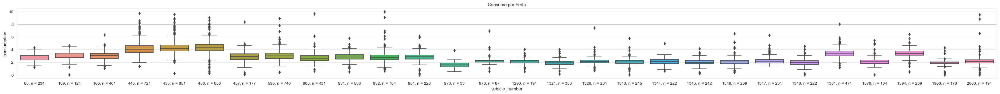

In [5]:
groups = abastecimentos.groupby('vehicle_number')
plt.figure(figsize=(1.5*len(groups), 3)) 

ax = sns.boxplot(data=abastecimentos, x='vehicle_number', y='consumption')
ax.set_xticklabels([f'{k}, n = {len(v)}' for k, v in groups])
ax.set_title('Consumo por Frota')

### Por Frota / PTO

Text(0.5, 1.0, 'Consumo por Frota')

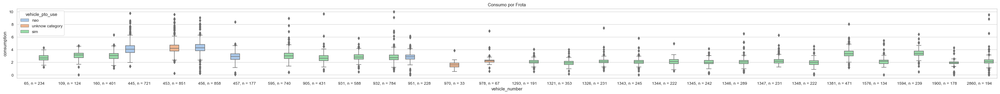

In [6]:
groups = abastecimentos.groupby('vehicle_number')
plt.figure(figsize=(1.5*len(groups), 3)) 

ax = sns.boxplot(data=abastecimentos, x='vehicle_number', y='consumption', hue='vehicle_pto_use')
ax.set_xticklabels([f'{k}, n = {len(v)}' for k, v in groups])
ax.set_title('Consumo por Frota')


### Veículos por Tipo

Text(0.5, 1.0, 'Veículos por Tipo')

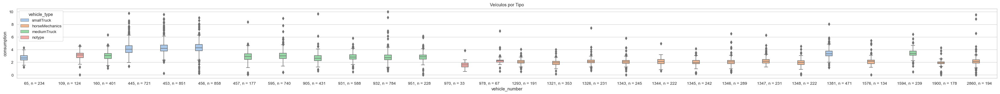

In [7]:
groups = abastecimentos.groupby('vehicle_number')
plt.figure(figsize=(1.5*len(groups), 3))
ax = sns.boxplot(
    data=abastecimentos, 
    x='vehicle_number', 
    y='consumption', 
    hue='vehicle_type'
)
ax.set_xticklabels([f'{k}, n = {len(v)}' for k, v in groups])
ax.set_title('Veículos por Tipo')

### Por Tipo e PTO

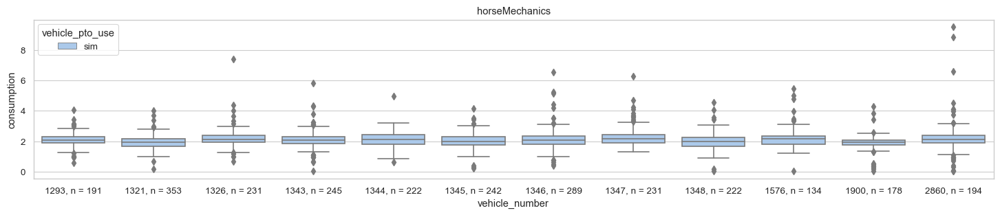

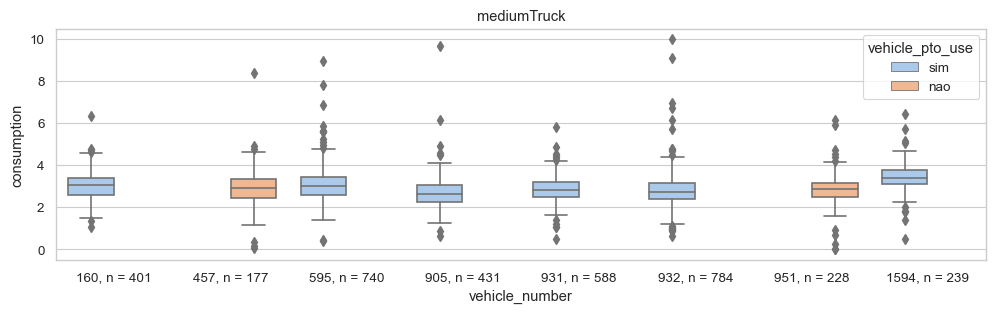

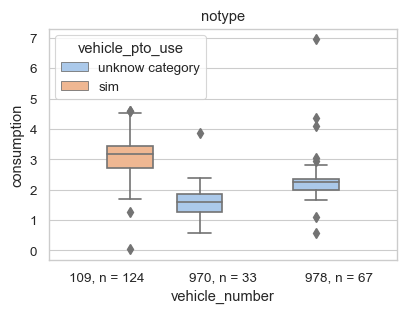

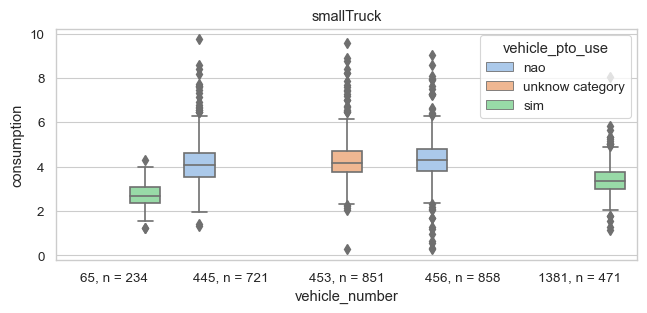

In [8]:
for tipo, tipo_group in abastecimentos.groupby('vehicle_type'):
    number_group = tipo_group.groupby('vehicle_number')
    plt.figure(figsize=(1.5*len(number_group), 3))
    ax = sns.boxplot(
        data=tipo_group, 
        x='vehicle_number', 
        y='consumption', 
        hue='vehicle_pto_use'
    )
    ax.set_xticklabels([f'{k}, n = {len(v)}' for k, v in number_group])
    ax.set_title(tipo)

### Por motorista

C:\Users\anton\AppData\Local\Temp\ipykernel_36480\2865083977.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(1.5*len(groups), 3))


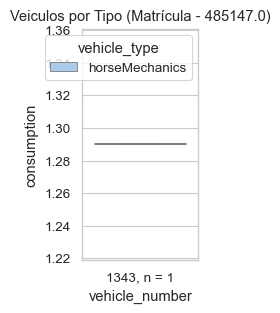

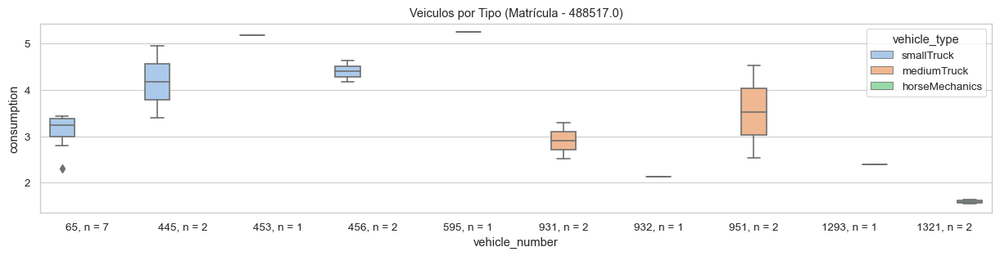

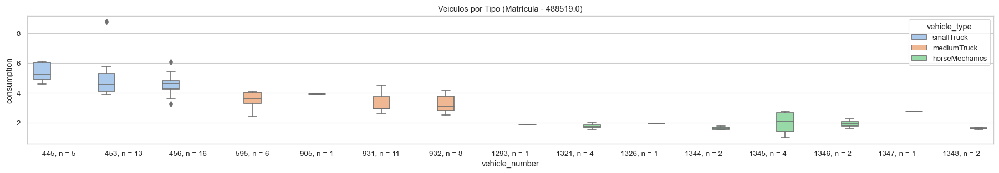

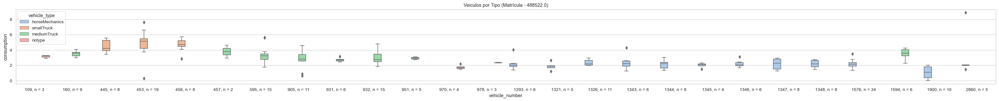

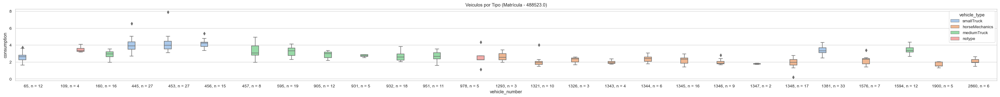

...

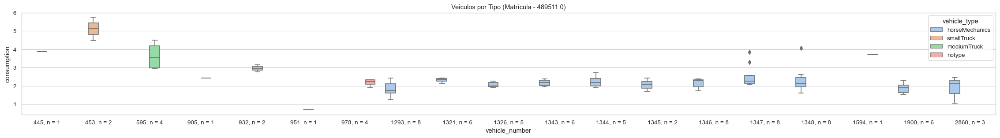

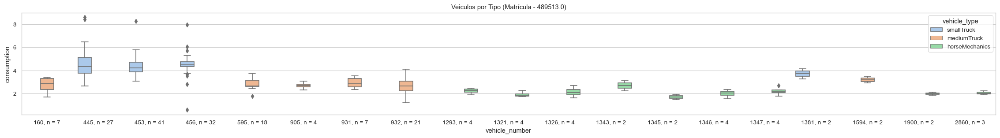

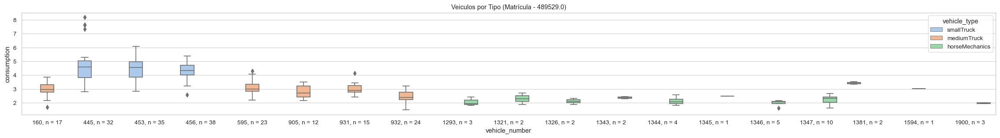

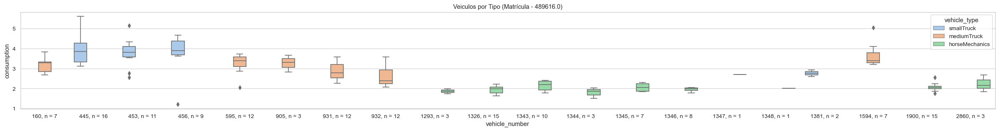

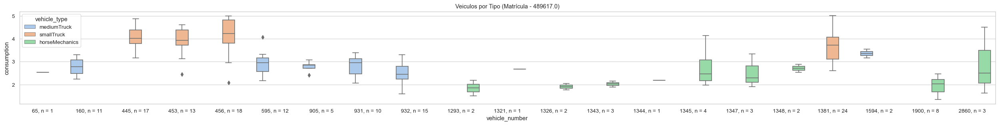

In [9]:
for mat, grupo_mat in abastecimentos.groupby('driver_registration'):
    groups = grupo_mat.groupby('vehicle_number')
    plt.figure(figsize=(1.5*len(groups), 3))
    ax = sns.boxplot(
        data=grupo_mat, 
        x='vehicle_number', 
        y='consumption', 
        hue='vehicle_type'
    )
    ax.set_xticklabels([f'{k}, n = {len(v)}' for k, v in groups])
    ax.set_title(f'Veiculos por Tipo (Matrícula - {mat})')

### Motorista

Text(0.5, 1.0, 'Consumo por Motorista')

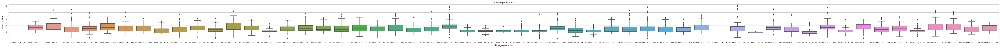

In [10]:
groups = abastecimentos.groupby('driver_registration')
plt.figure(figsize=(1.5*len(groups),3))
ax = sns.boxplot(x='driver_registration', y='consumption', data=abastecimentos)
ax.set_xticklabels([f'{k}, n = {len(v)}' for k, v in groups])
ax.set_title('Consumo por Motorista')

### Separando por Tipo

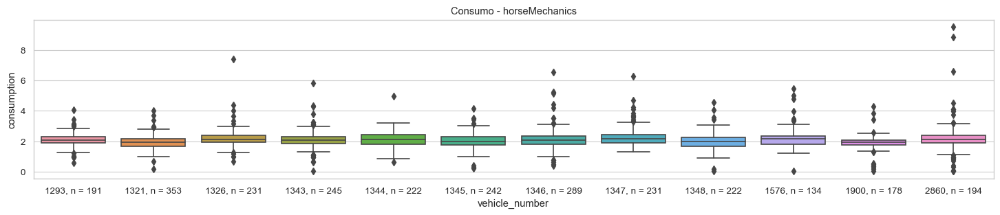

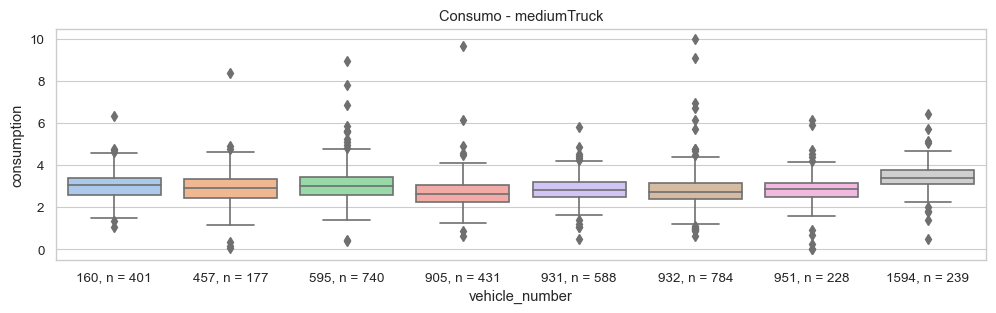

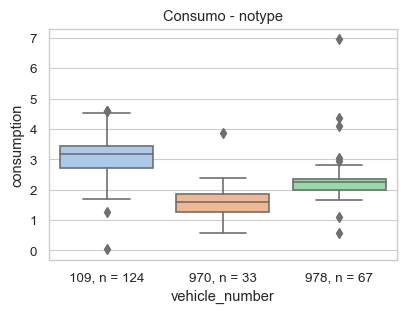

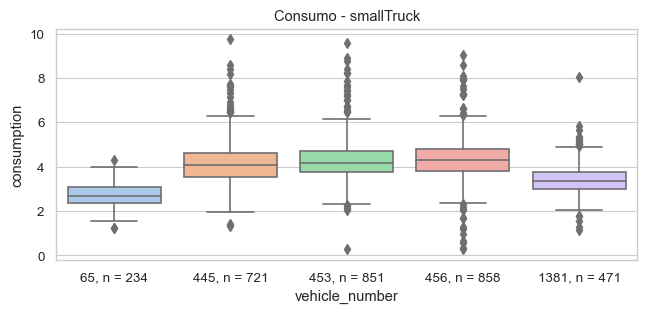

In [11]:
for type, group_type in abastecimentos.groupby('vehicle_type'):
    groups = group_type.groupby('vehicle_number')
    plt.figure(figsize=(1.5*len(groups),3))
    ax = sns.boxplot(data=group_type, x='vehicle_number', y='consumption')
    ax.set_xticklabels([f'{k}, n = {len(v)}' for k, v in groups])
    ax.set_title(f'Consumo - {type}')

### Motorista

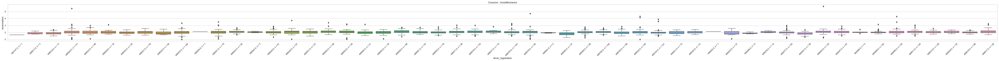

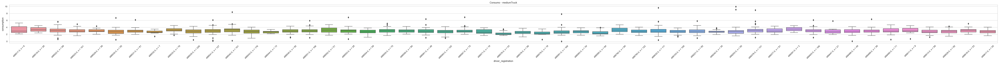

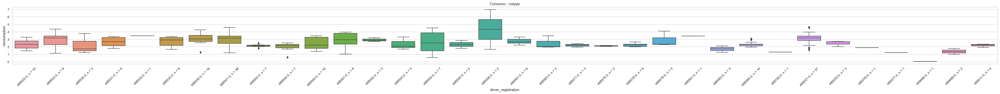

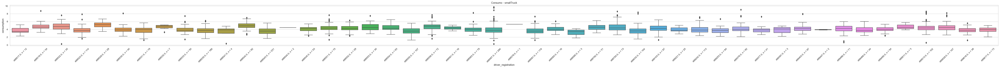

In [12]:
for type, group_type in abastecimentos.groupby('vehicle_type'):
    groups = group_type.groupby('driver_registration')
    plt.figure(figsize=(1.5*len(groups),3))
    ax = sns.boxplot(data=group_type, x='driver_registration', y='consumption')
    ax.set_xticklabels([f'{k}, n = {len(v)}' for k, v in groups], rotation=45)
    ax.set_title(f'Consumo - {type}')

___
## Consumo por mês

**Objetivo:** comparar o consumo das diferentes frotas e motoristas a cada mês de operação.

### Por Frota

C:\Users\anton\AppData\Local\Temp\ipykernel_36480\2928913320.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(1.5*len(groups), 3))


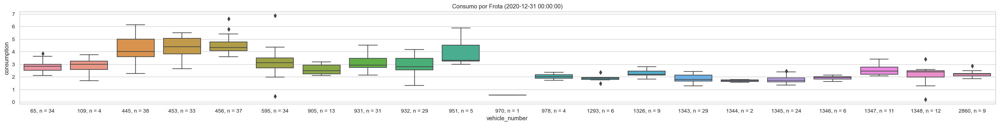

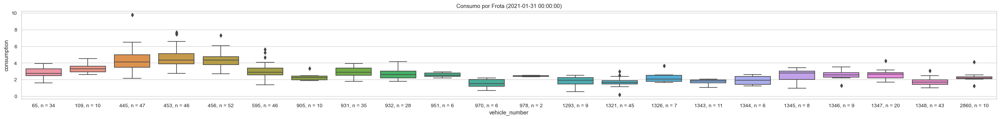

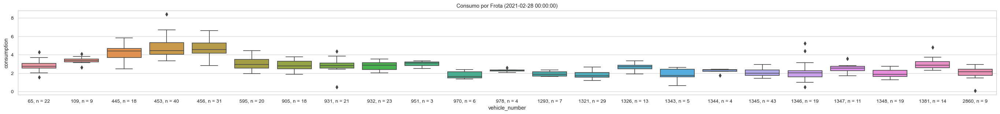

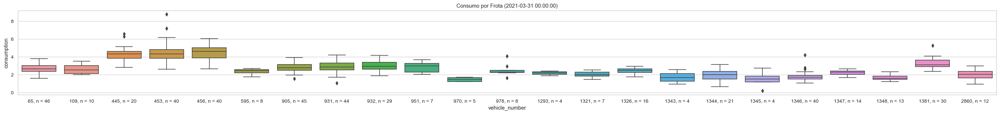

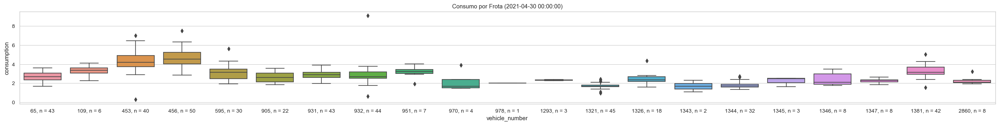

...

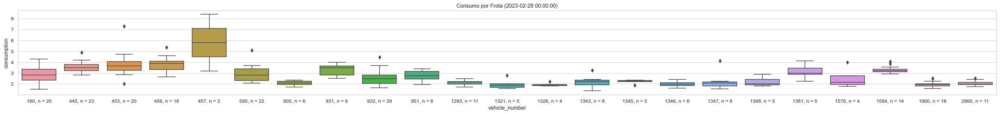

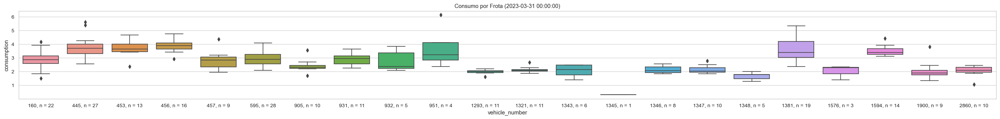

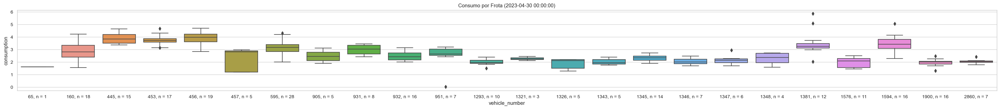

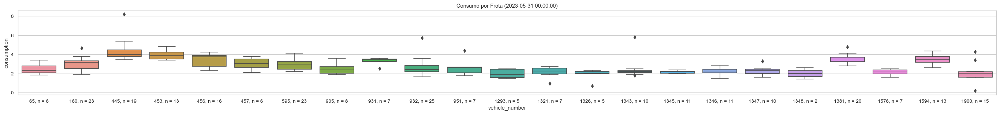

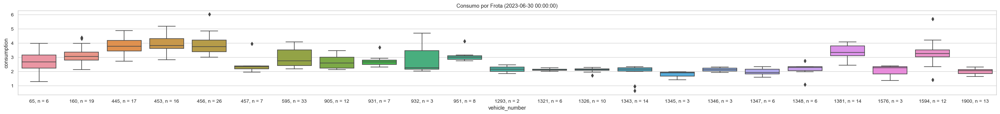

In [13]:
abastecimentos.index = abastecimentos['data']
for key, i in abastecimentos.groupby(pd.Grouper(freq='M')):
    groups = i.groupby('vehicle_number')
    plt.figure(figsize=(1.5*len(groups), 3)) 

    ax = sns.boxplot(data=i, x='vehicle_number', y='consumption')
    ax.set_xticklabels([f'{k}, n = {len(v)}' for k, v in groups])
    ax.set_title(f'Consumo por Frota ({key})')

### Motorista

C:\Users\anton\AppData\Local\Temp\ipykernel_36480\1452406837.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(1.5*len(groups), 3))


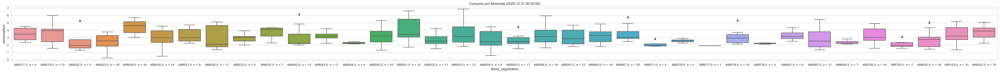

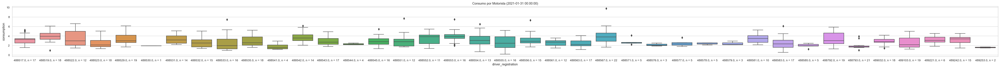

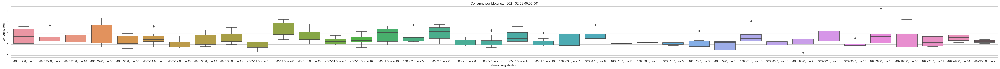

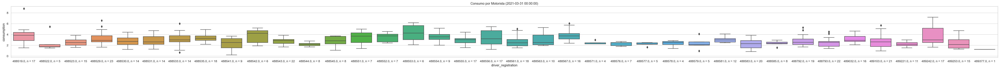

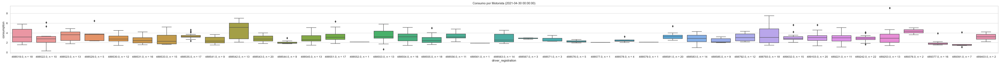

...

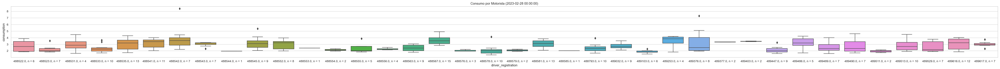

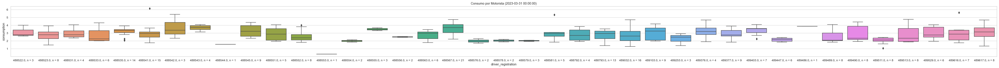

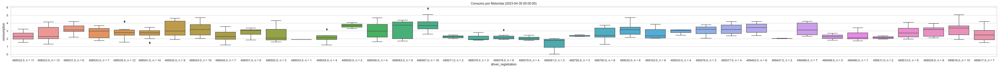

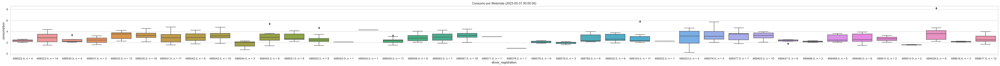

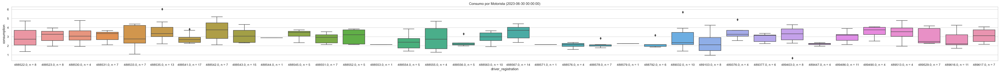

In [14]:
for key, i in abastecimentos.groupby(pd.Grouper(freq='M')):
    groups = i.groupby('driver_registration')
    plt.figure(figsize=(1.5*len(groups), 3)) 

    ax = sns.boxplot(data=i, x='driver_registration', y='consumption')
    ax.set_xticklabels([f'{k}, n = {len(v)}' for k, v in groups])
    ax.set_title(f'Consumo por Motorista ({key})')

___
## Consumo por mês separando por tipo de veículo

In [15]:
new_data = []
for month, data in abastecimentos.groupby(pd.Grouper(freq='M')):
    data['month_sequence'] = month.to_period('M')
    new_data.append(data)
abastecimentos = pd.concat(new_data)
abastecimentos['month_sequence']

C:\Users\anton\AppData\Local\Temp\ipykernel_36480\3757521397.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['month_sequence'] = month.to_period('M')
C:\Users\anton\AppData\Local\Temp\ipykernel_36480\3757521397.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['month_sequence'] = month.to_period('M')
C:\Users\anton\AppData\Local\Temp\ipykernel_36480\3757521397.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_inde

data
2020-12-01 21:33:28    2020-12
2020-12-02 09:28:29    2020-12
2020-12-02 13:31:59    2020-12
2020-12-02 19:38:38    2020-12
2020-12-02 22:22:18    2020-12
                        ...   
2023-06-28 14:28:03    2023-06
2023-06-28 15:23:48    2023-06
2023-06-28 16:09:00    2023-06
2023-06-28 23:44:08    2023-06
2023-06-29 09:11:11    2023-06
Name: month_sequence, Length: 9679, dtype: period[M]

### Frota

C:\Users\anton\AppData\Local\Temp\ipykernel_36480\4248207225.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(1.5*len(groups), 3))


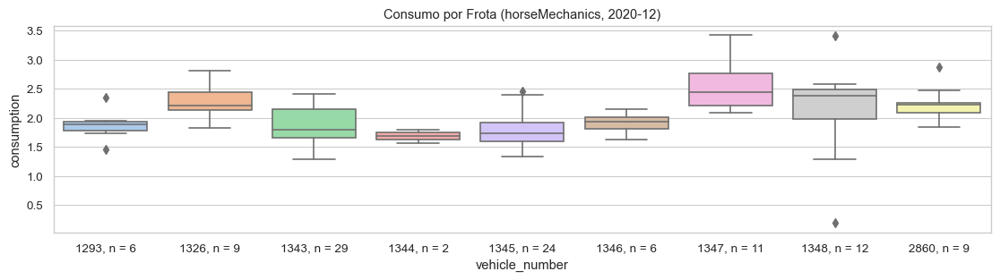

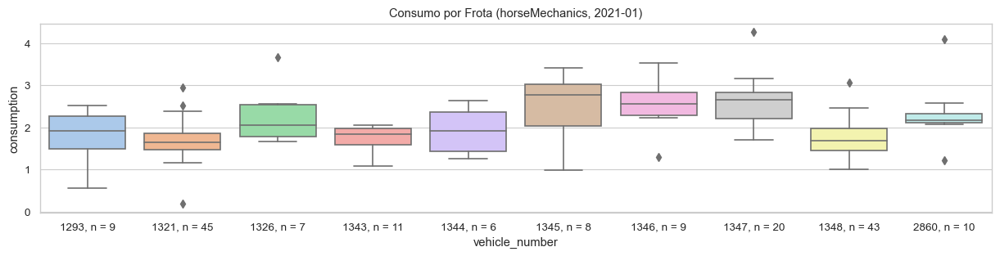

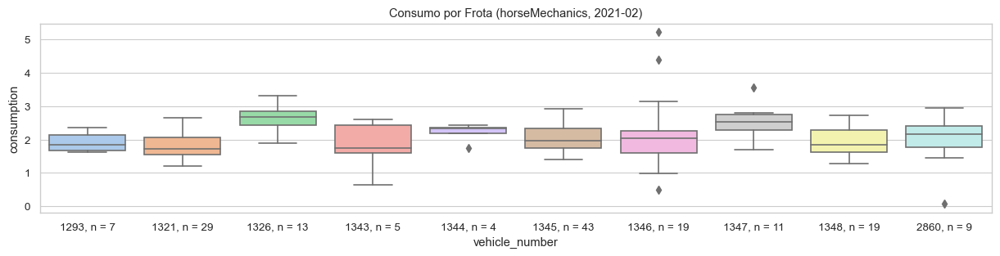

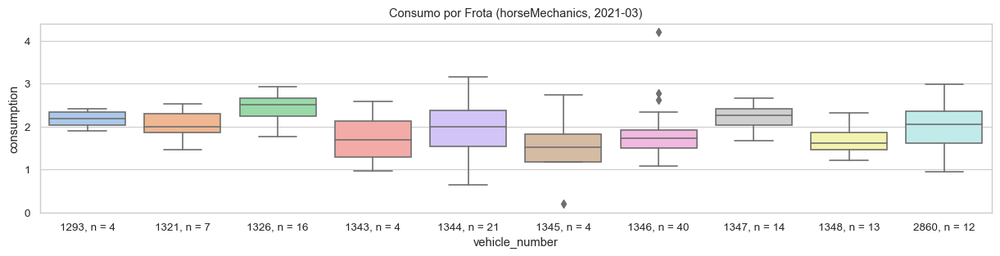

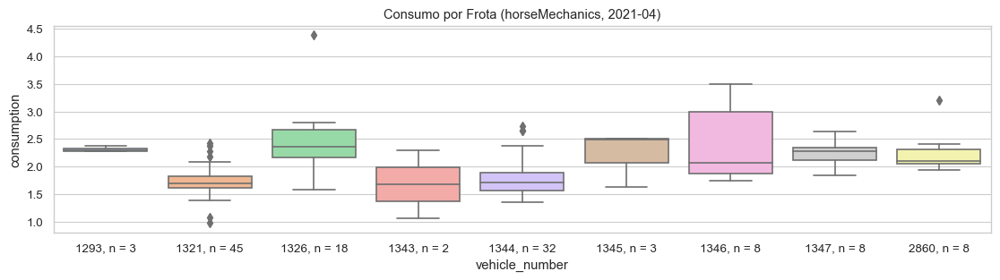

...

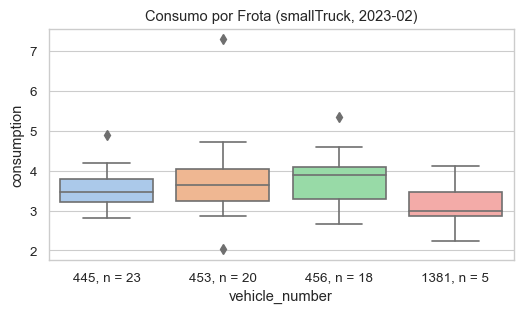

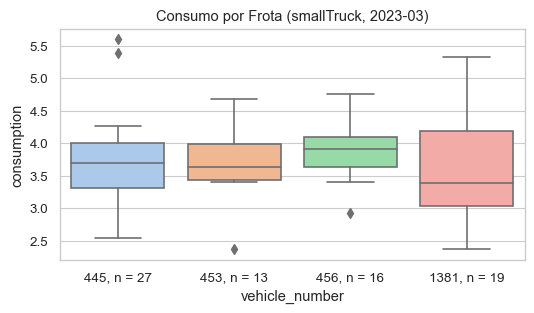

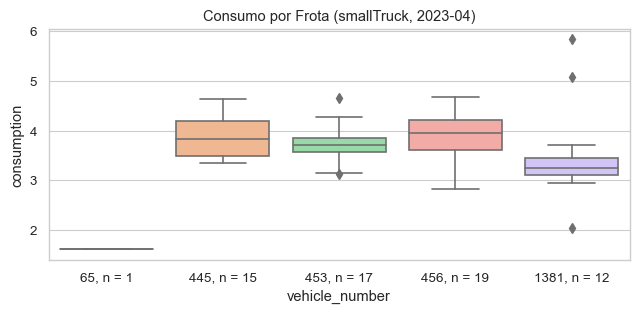

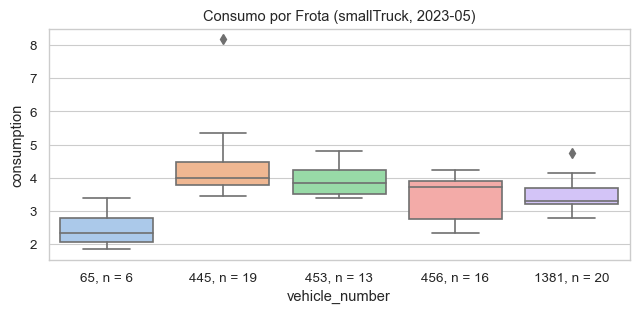

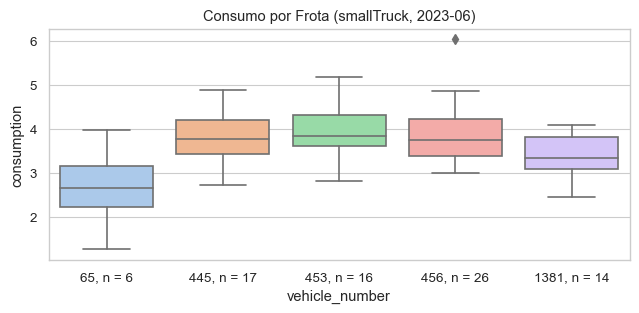

In [16]:
for type, type_group in abastecimentos.groupby('vehicle_type'):
    for month, month_group in type_group.groupby('month_sequence'):
        groups = month_group.groupby('vehicle_number')
        plt.figure(figsize=(1.5*len(groups), 3)) 

        ax = sns.boxplot(data=month_group, x='vehicle_number', y='consumption')
        ax.set_xticklabels([f'{k}, n = {len(v)}' for k, v in groups])
        ax.set_title(f'Consumo por Frota ({type}, {month})')

### Motorista

C:\Users\anton\AppData\Local\Temp\ipykernel_36480\1574074249.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(1.5*len(groups), 3))


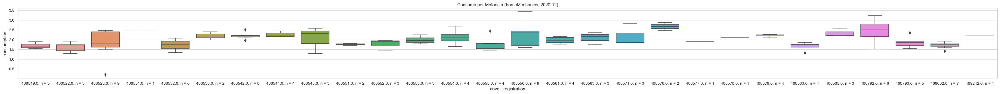

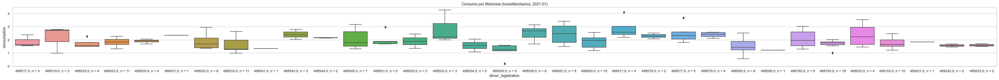

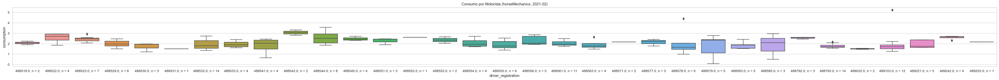

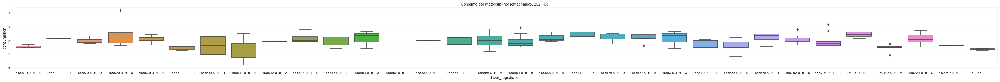

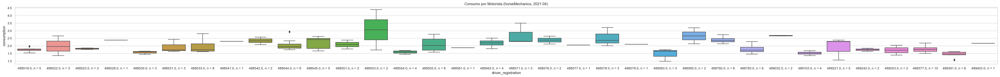

...

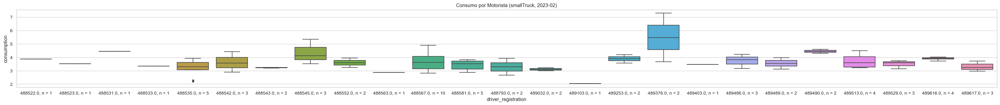

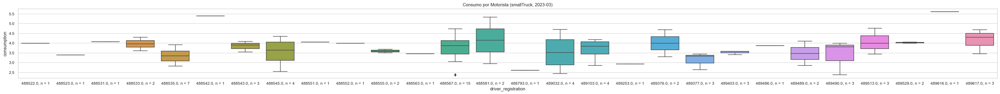

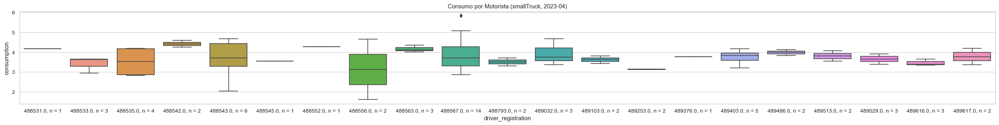

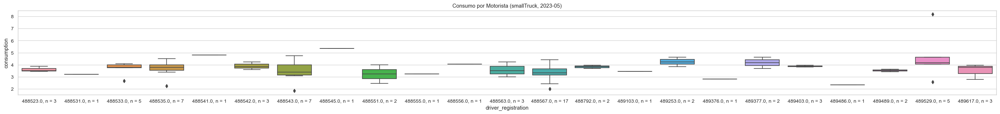

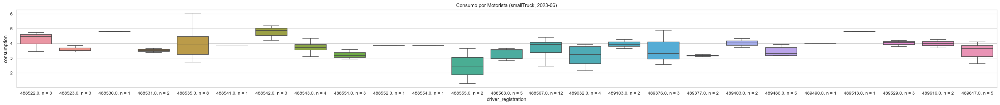

In [17]:
for type, type_group in abastecimentos.groupby('vehicle_type'):
    for month, month_group in type_group.groupby('month_sequence'):
        groups = month_group.groupby('driver_registration')
        plt.figure(figsize=(1.5*len(groups), 3)) 

        ax = sns.boxplot(data=month_group, x='driver_registration', y='consumption')
        ax.set_xticklabels([f'{k}, n = {len(v)}' for k, v in groups])
        ax.set_title(f'Consumo por Motorista ({type}, {month})')

___
## Evolução do consumo das frotas e motoristas

**Objetivo:** avaliar a evolução do consumo de combustível de cada frota e de cada motorista ao longo do tempo.

C:\Users\anton\AppData\Local\Temp\ipykernel_36480\283267499.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(1.5*len(groups), 3))


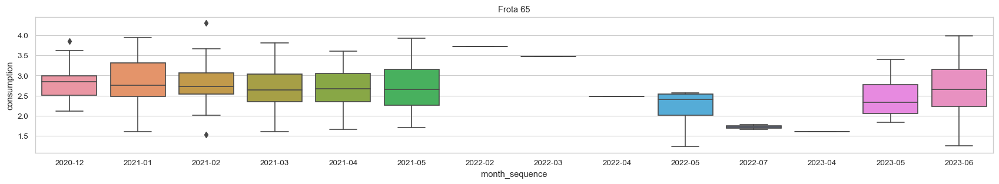

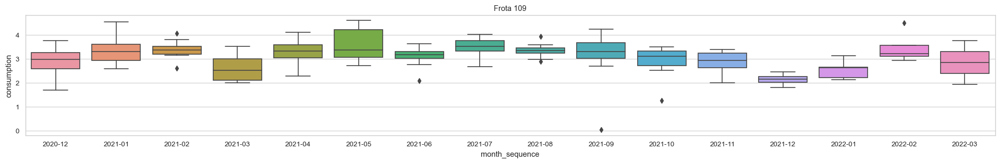

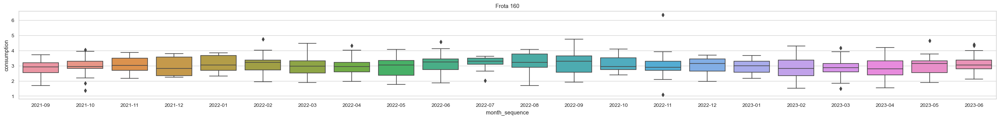

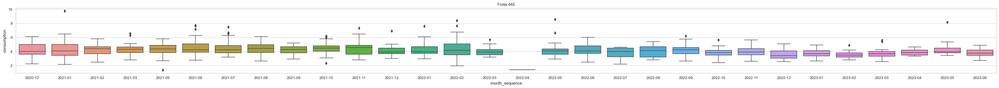

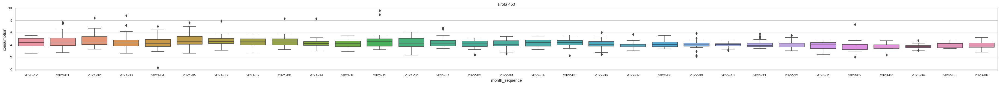

...

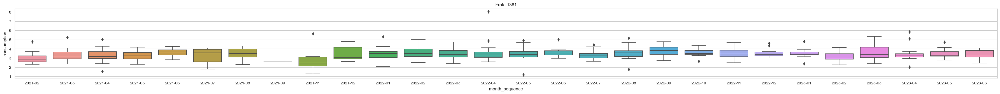

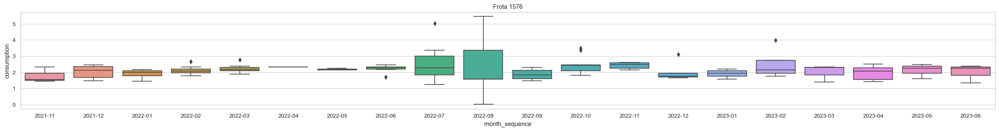

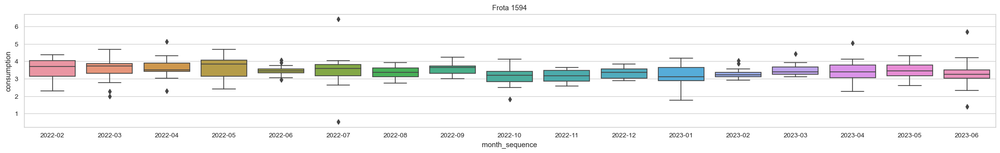

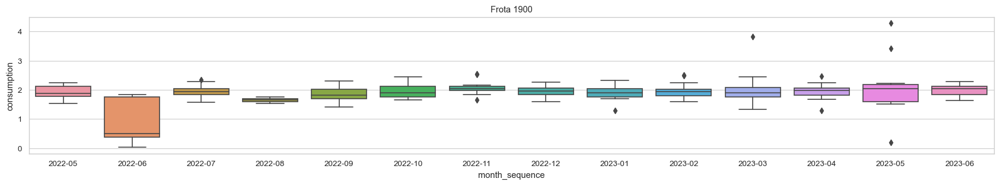

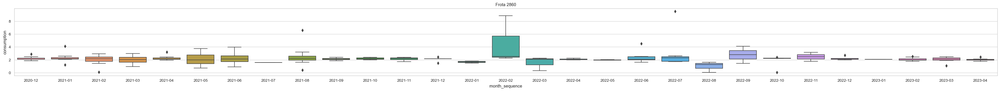

In [18]:

for frota, data in abastecimentos.groupby('vehicle_number'):
    groups = data.groupby('month_sequence')
    plt.figure(figsize=(1.5*len(groups), 3)) 
    box = sns.boxplot(x='month_sequence', y='consumption', data=data)
    box.set_title(f'Frota {frota}')

### Motorista

C:\Users\anton\AppData\Local\Temp\ipykernel_36480\1222505992.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(1.5*len(groups), 3))


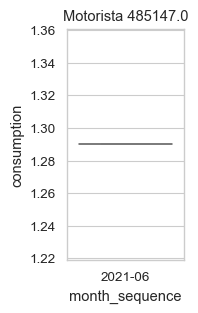

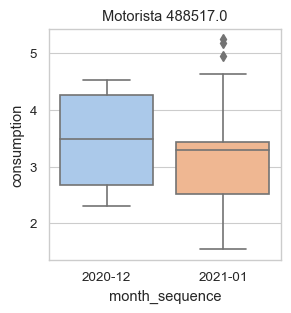

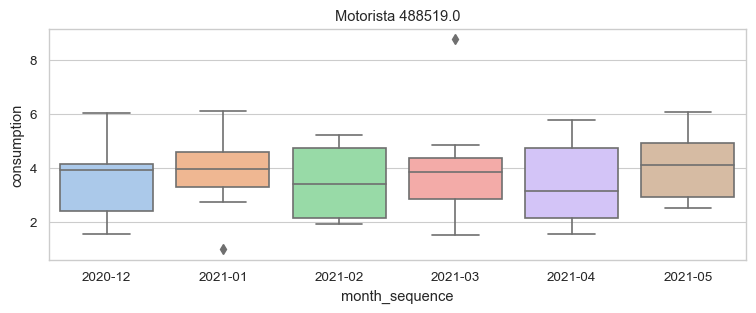

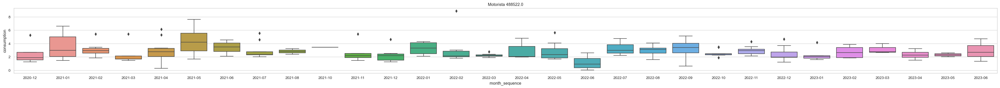

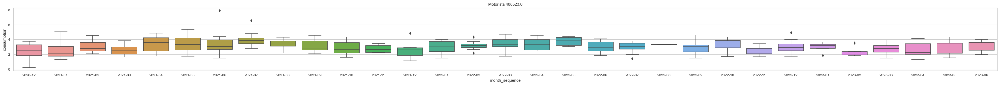

...

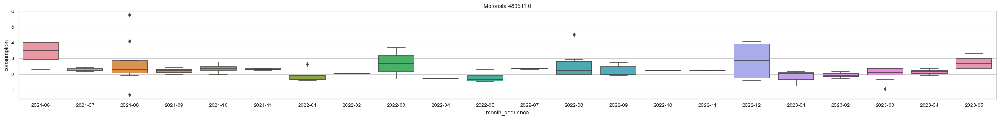

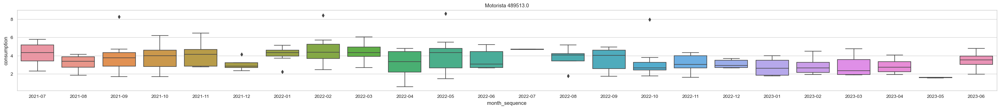

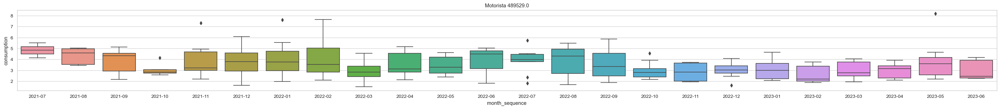

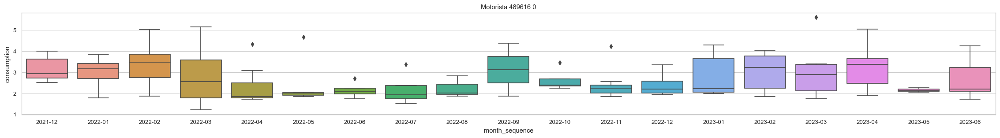

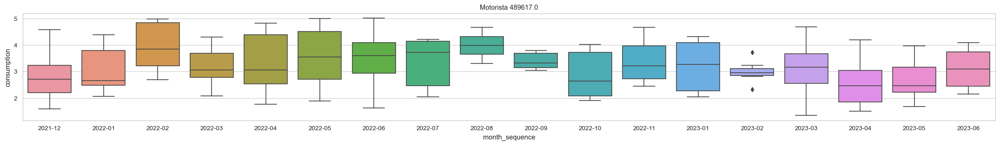

In [19]:

for driver_registration, data in abastecimentos.groupby('driver_registration'):
    groups = data.groupby('month_sequence')
    plt.figure(figsize=(1.5*len(groups), 3)) 
    box = sns.boxplot(x='month_sequence', y='consumption', data=data)
    box.set_title(f'Motorista {driver_registration}')

___
## Evolução do consumo das frotas e motoristas separando por tipo de veiculo

### Frota

C:\Users\anton\AppData\Local\Temp\ipykernel_36480\950343846.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(1.5*len(groups), 3))


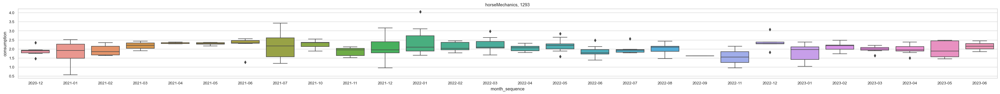

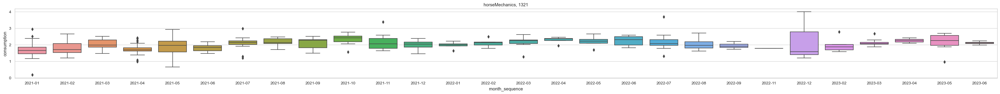

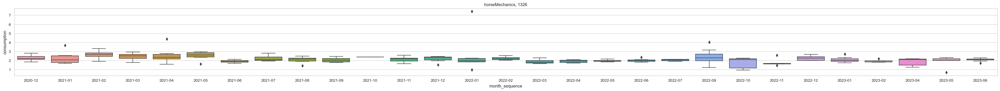

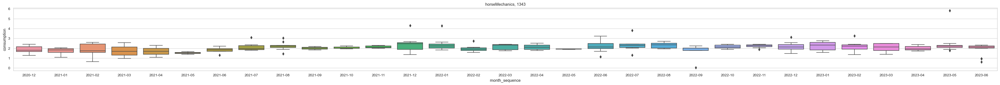

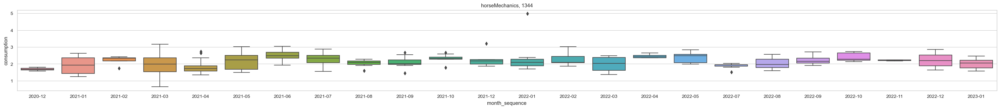

...

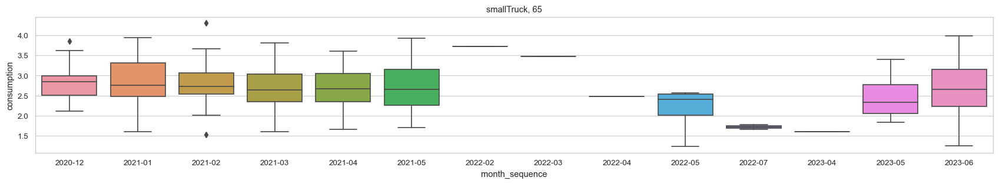

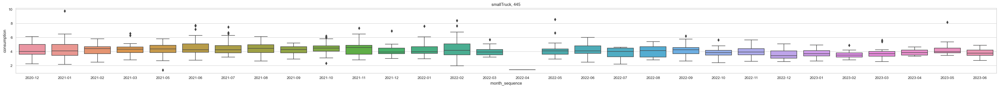

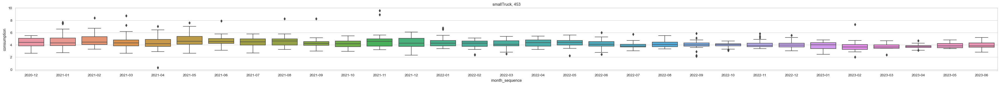

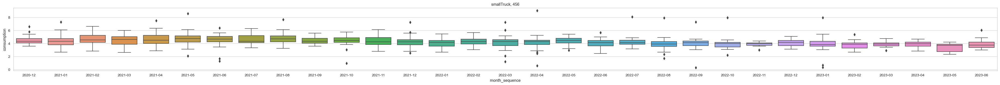

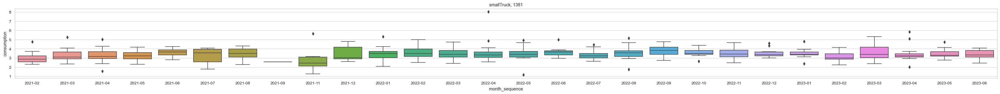

In [20]:
for type, type_group in abastecimentos.groupby('vehicle_type'):
    for frota, frota_group in type_group.groupby('vehicle_number'):
        groups = frota_group.groupby('month_sequence')
        plt.figure(figsize=(1.5*len(groups), 3)) 
        box = sns.boxplot(x='month_sequence', y='consumption', data=frota_group)
        box.set_title(f'{type}, {frota}')

### Motorista

C:\Users\anton\AppData\Local\Temp\ipykernel_36480\412269700.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(1.5*len(groups), 3))


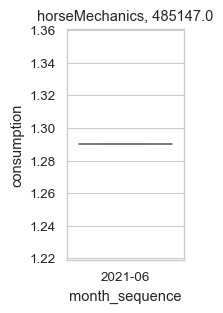

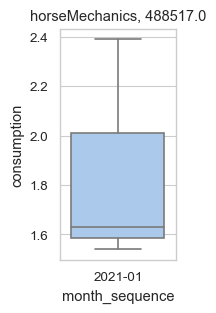

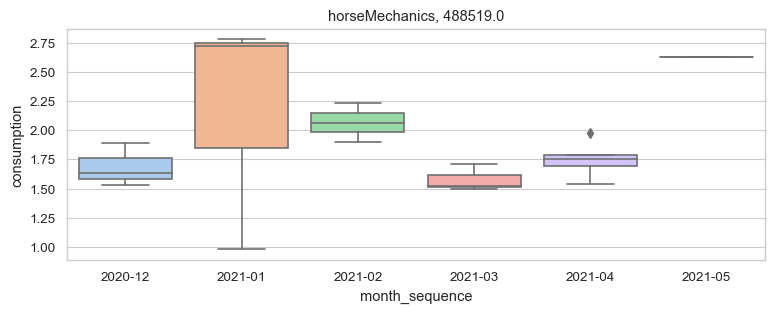

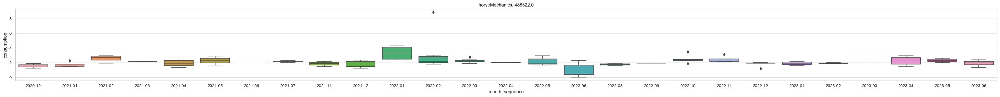

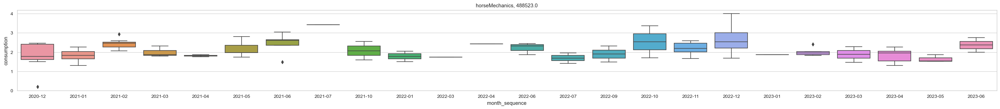

...

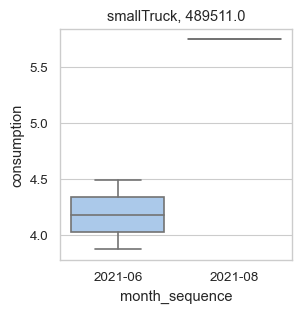

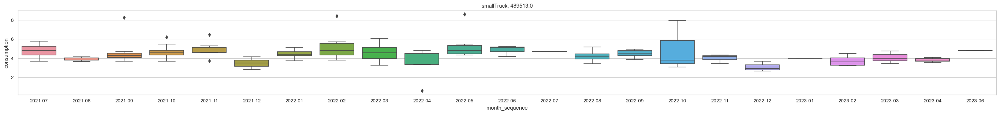

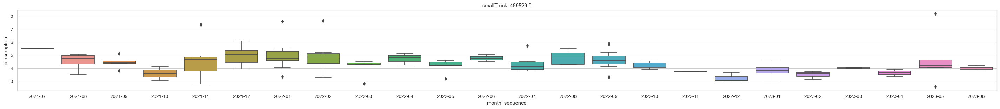

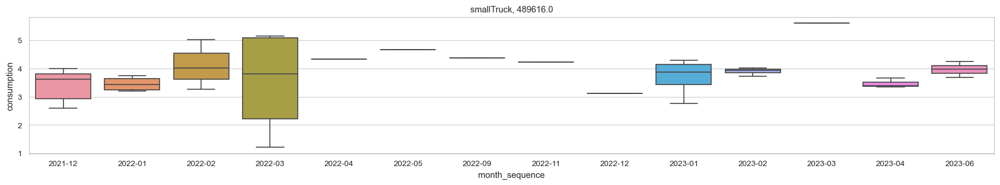

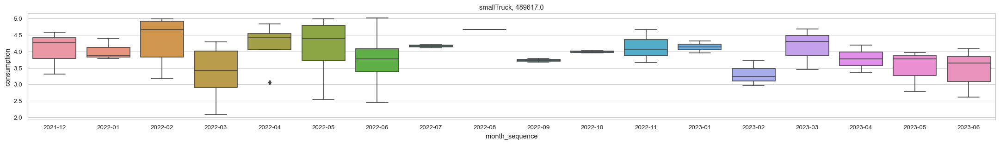

In [21]:
for type, type_group in abastecimentos.groupby('vehicle_type'):
    for driver, driver_group in type_group.groupby('driver_registration'):
        groups = driver_group.groupby('month_sequence')
        plt.figure(figsize=(1.5*len(groups), 3)) 
        box = sns.boxplot(x='month_sequence', y='consumption', data=driver_group)
        box.set_title(f'{type}, {driver}')

___
## Consumo por combinação de frota e motorista

**Objetivo:** avaliar se existem combinações específicas de motorista e frota que apresentam valores bons e ruins de consumo de combustível.

C:\Users\anton\AppData\Local\Temp\ipykernel_36480\3641981941.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(1.5*len(groups), 3))


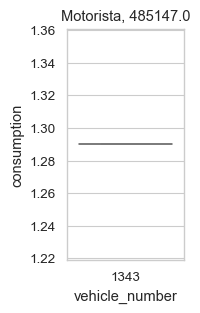

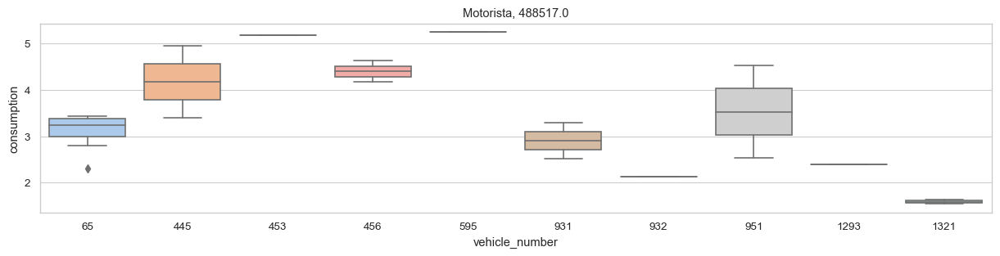

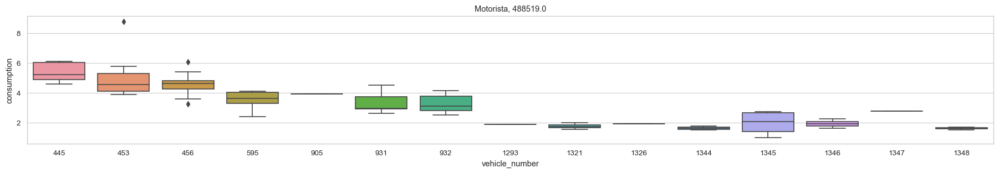

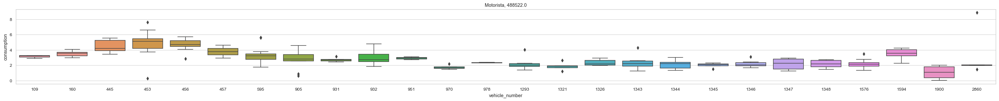

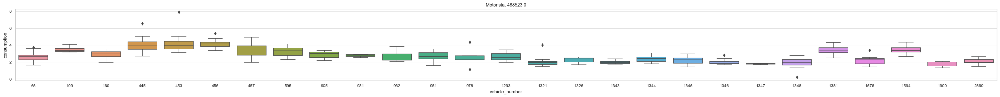

...

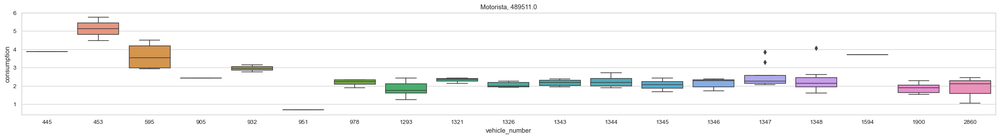

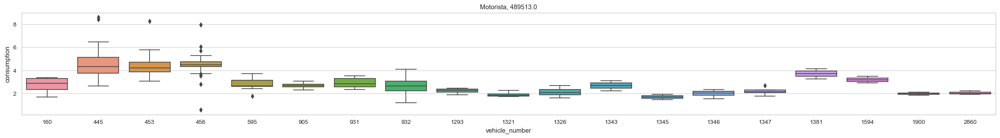

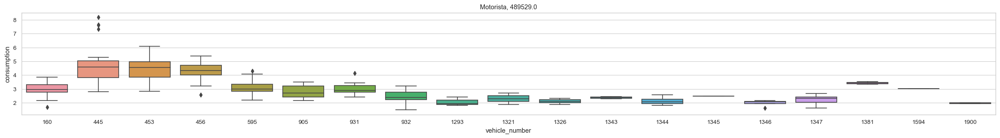

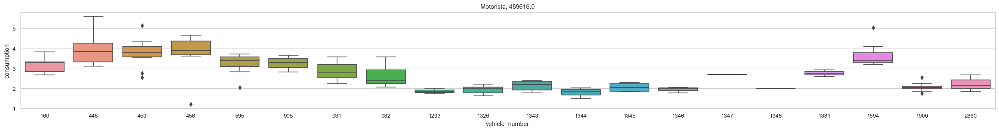

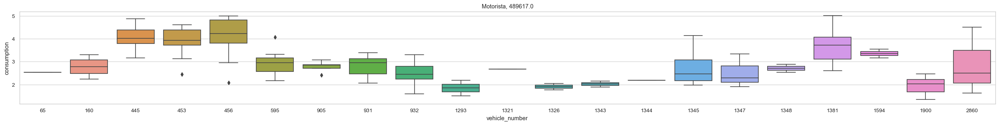

In [22]:

for driver, driver_group in abastecimentos.groupby('driver_registration'):
    groups = driver_group.groupby('vehicle_number')
    plt.figure(figsize=(1.5*len(groups), 3)) 
    box = sns.boxplot(x='vehicle_number', y='consumption', data=driver_group)
    box.set_title(f'Motorista, {driver}')

___
## Consumo por combinação de frota e motorista por tipo de veiculo

### Frota por motorista

C:\Users\anton\AppData\Local\Temp\ipykernel_36480\1956881986.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(1.5*len(groups), 3))


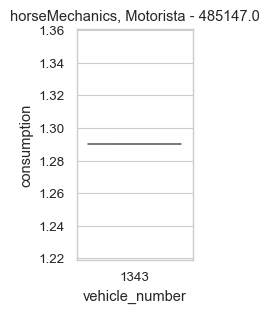

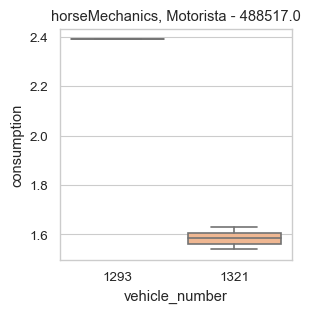

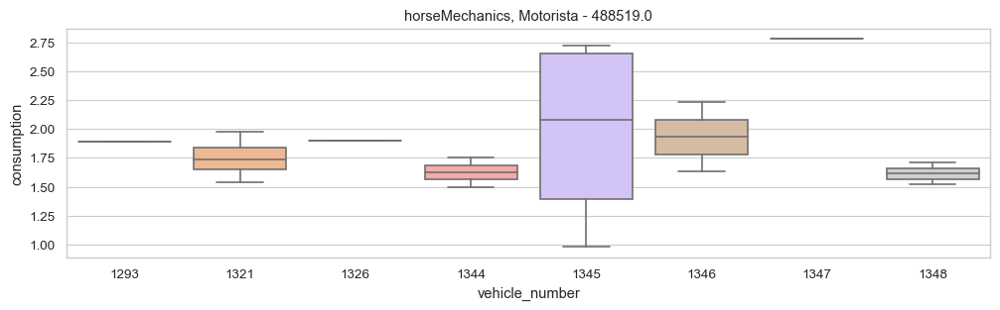

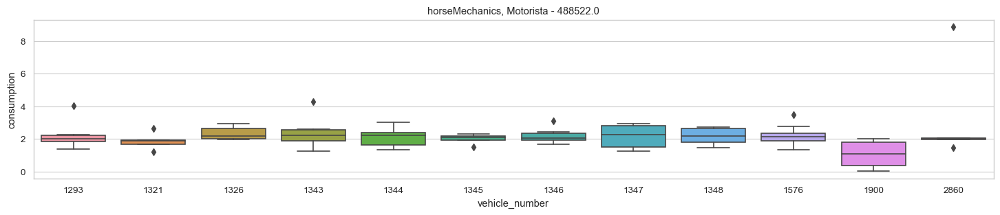

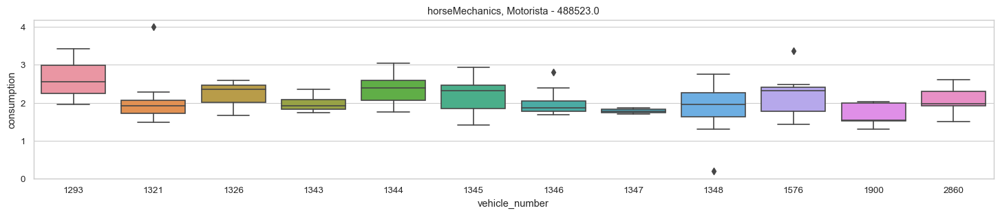

...

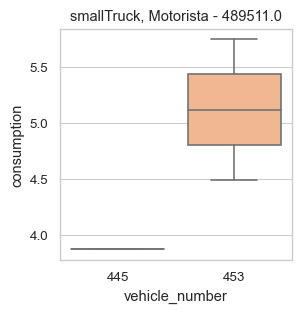

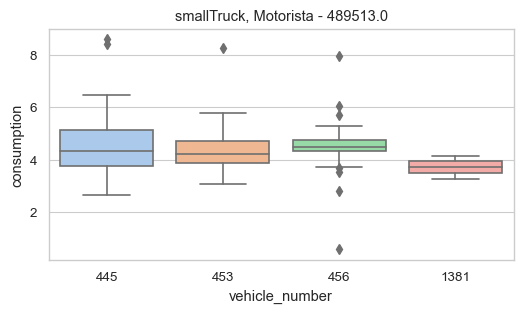

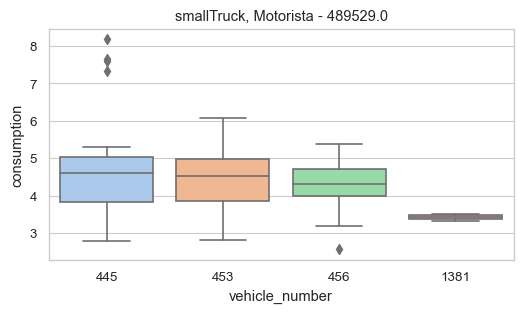

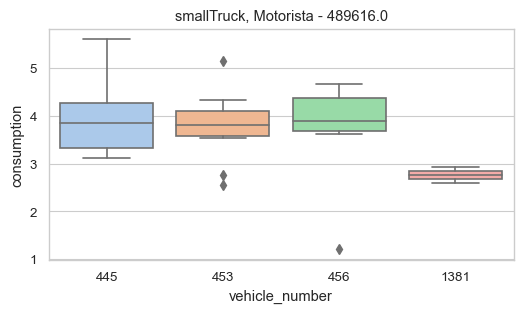

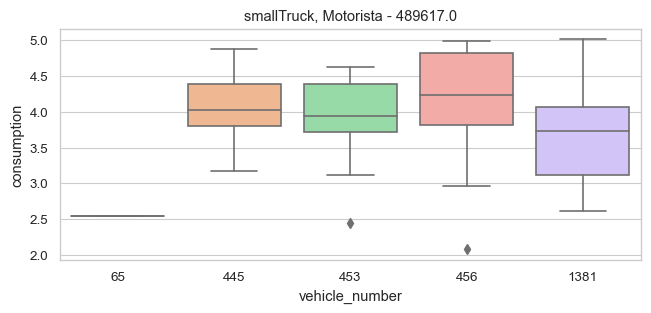

In [23]:
for type, type_group in abastecimentos.groupby('vehicle_type'):
    for driver, driver_group in type_group.groupby('driver_registration'):
        groups = driver_group.groupby('vehicle_number')
        plt.figure(figsize=(1.5*len(groups), 3)) 
        box = sns.boxplot(x='vehicle_number', y='consumption', data=driver_group)
        box.set_title(f'{type}, Motorista - {driver}')

### Motorista por frota

C:\Users\anton\AppData\Local\Temp\ipykernel_36480\3295697138.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(1.5*len(groups), 3))


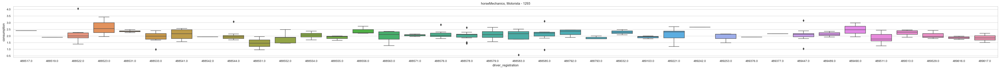

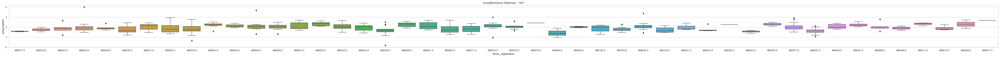

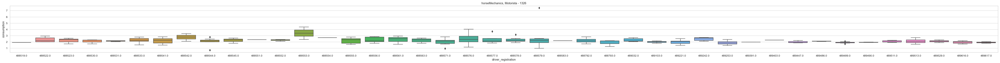

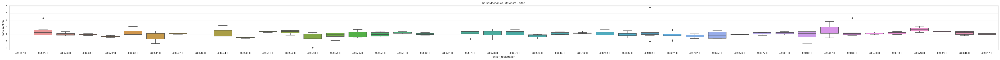

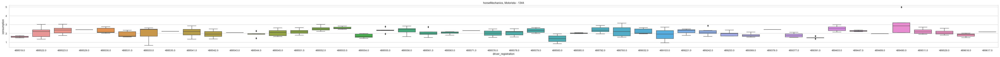

...

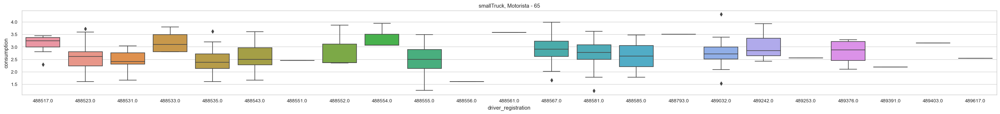

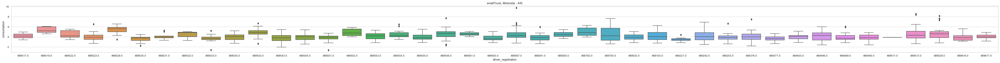

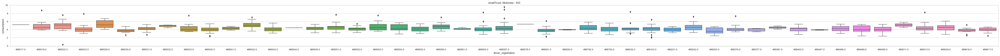

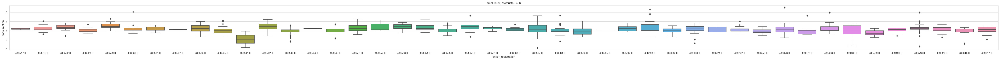

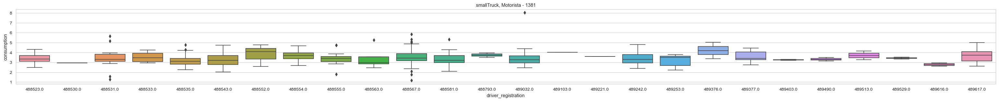

In [24]:
for type, type_group in abastecimentos.groupby('vehicle_type'):
    for vehicle, vehicle_group in type_group.groupby('vehicle_number'):
        groups = vehicle_group.groupby('driver_registration')
        plt.figure(figsize=(1.5*len(groups), 3)) 
        box = sns.boxplot(x='driver_registration', y='consumption', data=vehicle_group)
        box.set_title(f'{type}, Motorista - {vehicle}')